# Part 3 - Vectorizing with BOW and TF-IDF

Author: Laura Mercy

Date: 2022-12-12

Contact: laura.mercym@gmail.com

# Introduction

In Part 2, we ran some machine learning models on the books features, *excluding* title and description as they are text data and need to be dealt with separately. Let's recap the scores we got on just the non-text features:

Model | Remainder | Test
:------|:-----------|:------
LR, Standard Scaler, C=0.001 | 65.7% | 63.8%
LR, MinMax Scaler, C=100 | 65.6% | 63.7%
KNN, Standard Scaler, K=25 | 69.5% | 65.7%
KNN, RobustScaler, K=37 | 70.6% | 67.8%
DT, unscaled, M=3 | 63.7% | 62.3%
DT, unscaled, M=6 | 66.1% | 64.5%
RF, unscaled, n=60, M=5 | 67.0% | 65.5%

We will now add word vectors to those intial features, using 4 different methods:

- CountVectorizer, or the Bag of Words methodology
- TF-IDF
- Word2Vec
- GloVe

To ensure that the notebook runs smoothly, we have split the work into 2 notebooks: Part 3 will look at the first 2 techniques, and Part 4 will address the last 2 which will need a different conda environment. For this one, a regular Python3 kernel is fine.

We will proceed in 5 steps for each method, in this exact order to avoid data leakage:

1. Split the dataset into train & test set
2. Convert the description and title into vectors on the train set *only*
3. Transform the test set using the same model as for the train set, meaning that words that did not exist in the train set but do exist in the test set will be ignored
4. Merge the description vectors and the title vectors with the rest of the features, for the train and test sets respectively
5. Fit ML models as usual and assess the performance

#### A word on words

As anything in Machine Learning, we need to have data in a numeric form to run models. How do we do that with words? Well, that is the concept behind Natural Language Processing, or NLP. In this notebook, we will look at 2 methods:

- Bag of Words, which counts the number of unique words or part of words (the tokens) in our entire dataset (the corpus) for each book entry (the document)
- TF-IDF (Term Frequency - Inverse Document Frequency) , which is a weighted count of the tokens based on their relevance in the corpus.

We can also ensure that we are working with text that is as clean as possible and as similar as possible across the whole corpus by removing punctuation, putting all words in lower case, removing stop words that do not convey any particular meaning, and even shorten words to their root to avoid variations of the same word. We will go through these steps when we start vectorizing the words.

But first, we import the librairies that we will need for this work, as usual.

In [1]:
#import libraries
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

pd.set_option('display.max_columns', None)

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler

from sklearn.model_selection import train_test_split, GridSearchCV

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier,KNeighborsTransformer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.decomposition import PCA

from sklearn.metrics import plot_roc_curve
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix, confusion_matrix

# To build a pipeline
from sklearn.pipeline import Pipeline

# To get rid of logistic regression default solver warnings that appear if sklearn hasn't been updated
import warnings
warnings.filterwarnings('ignore')

#To do some cross validation
from sklearn.model_selection import cross_val_score

We also import our data, the same cleaned dataset that we have been working with in Part 2.

In [2]:
#import data
books_df=pd.read_csv("data/books_df_clean.csv")
books_df.head()

,Unnamed: 0,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year,is_popular
0,0,The Hunger Games,WINNING MEANS FAME AND FORTUNE.LOSING MEANS CE...,374,3,1,12,147,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,1,0,0,0,1,2008,1
1,1,Harry Potter and the Order of the Phoenix,There is a door at the end of a silent corrido...,870,8,1,24,136,0,1,0,1,1,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,2004,1
2,2,To Kill a Mockingbird,The unforgettable novel of a childhood in a sl...,324,4,1,2,137,0,0,0,0,1,0,0,1,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,1,2006,1
3,3,Pride and Prejudice,Alternate cover edition of ISBN 9780679783268S...,279,3,0,14,100,1,0,0,0,1,0,0,1,1,1,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,2000,1
4,4,Twilight,About three things I was absolutely positive.\...,501,1,1,14,55,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,1,0,1,2009,0


Again, we drop the duplicated index column.

In [3]:
#Drop Unnamed
books_df.drop(['Unnamed: 0'],axis=1,inplace=True)

And finally we check the shape.

In [4]:
#check shape
books_df.shape

(39039, 41)

As before, we have 39,039 rows and 41 columns. We are ready to start.

# 1. Bag of Words (Count Vectorizer)

To transform words into a count, we import the CountVectorizer model from SK Learn. We also import nltk, which is a widely used NLP package, to help us removing stop words and stemming words (i.e removing the ending of a word to keep only the common root). The python string package has a punctuation list that can also be helpful.

In [5]:
#import the librairies
from sklearn.feature_extraction.text import CountVectorizer

# import the nltk stopwords
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords 

#import the nltk stemmer
stemmer = nltk.stem.PorterStemmer()

#creating a list of english stop words
english_stop_words = stopwords.words('english')

# importing the python string package
import string

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/lauramercy/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


We will see that the CountVectorizer takes in some arguments like removing stop words and turning words into a lower case, but we can also create our own custom tokenizer using different corpus of stopwords (nltk in this case) and stemming the words using the PrterStemmer we imported earlier.

In [6]:
#creating a custom tokenizer

def my_tokenizer(review):
    
    # remove punctuation and set to lower case
    for punctuation_mark in string.punctuation:
        review = review.replace(punctuation_mark,'').lower()

    # split sentence into words
    listofwords = review.split(' ')
    listofstemmed_words = []
    
    # remove stopwords and any tokens that are just empty strings
    for word in listofwords:
        if (not word in english_stop_words) and (word!=''):
            
            # Stem words
            stemmed_word = stemmer.stem(word)
            listofstemmed_words.append(stemmed_word)

    return listofstemmed_words

Before we start, we need to define our X and y variables just like any other model, and split the dataset into a train and test set. We'll do the split the exact same way as in part 2, using the same random state and the stratify argument.

In [7]:
#Redefining the variables
X=books_df.drop('is_popular',axis=1)
y=books_df['is_popular']

In [8]:
# Split the data train/test set the same way as earlier
X_train, X_test, y_train, y_test= train_test_split (X, y, test_size=0.2, stratify=y, random_state=1)

In [9]:
#Looking at the first rows of X Train
X_train.head()

,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year
12988,The Radium Girls: The Dark Story of America's ...,\n The incredible true story of the women who...,479,10,0,1,231,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,2017
4460,The Dark Web Murders,I AM MEMEIN. I AM EMOTIONALLY DETACHED FROM MY...,416,4,1,2,238,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2019
19577,I Sold Myself To The Devil For Vinyls... Pitif...,"Lexi Grayson is just a normal teenager, as nor...",421,11,1,1,38,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,2014
35307,The Devil Knows You're Dead,"Scudder is back, tracking a killer through the...",338,5,1,14,99,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,1999
12699,Chariots of The Gods,Erich von Daniken's Chariots of the Gods is a ...,220,4,0,2,178,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1999


Before we start looking deeper into vectorizing the words, we can run a quick pipeline on description only and on title only, to have an idea of their performance.

## 1.1 Quick Pipeline on Description and Title only

Before we transform the description and title into vectors and optimize the model, we can run a quick pipeline on Description and title in isolation to see how they score. Thse pipelines do not have optimized parameters though, so we'll take the results as a baseline only.

##### Quick LR on Description only 

We'll set up a basic Logistic Regression pipeline with a Count Vectorizer on the description, using the same C as in part 2.

In [10]:
#Instantiate the pipeline

logreg = Pipeline(
    [
        ("vectorizer", CountVectorizer(lowercase=True, stop_words='english', min_df=15)),
        ("classifier", LogisticRegression(max_iter=1000,C=0.001)),
    ]
)

#Fit the pipeline
logreg.fit(X_train['description'],y_train);

# accuracy scores
print(f"train accuracy: {logreg.score(X_train['description'], y_train)}")
print(f"test accuracy: {logreg.score(X_test['description'], y_test)}")

train accuracy: 0.6655246389805002
test accuracy: 0.6247438524590164


Trying to predict the popularity of a book based on description only gives us a 62.5% accuracy on the test set, more or less the same as we've had in the previous models, but with description alone. Let's see what we get when we do the same thing on title only.

#### Quick LR on Title only

In [11]:
#Instantiate the pipeline

logreg = Pipeline(
    [
        ("vectorizer", CountVectorizer(lowercase=True, stop_words='english', min_df=15)),
        ("classifier", LogisticRegression(max_iter=1000,C=0.001)),
    ]
)

#Fit the pipeline
logreg.fit(X_train['title'],y_train);

# accuracy scores
print(f"train accuracy: {logreg.score(X_train['title'], y_train)}")
print(f"test accuracy: {logreg.score(X_test['title'], y_test)}")

train accuracy: 0.5158016073772854
test accuracy: 0.5157530737704918


That's a pretty terrible score. Which tells use that the title alone is definitely not enough to predict popularity. Let's do the full work and convert description, title, and merge the vectors with the rest of the features.

## 1.2 Converting Description

As with the other models, we have to instantiate and fit the model on the train data, before transforming it.

In [12]:
#Transform Description

# Instantiate 
bagofwords_desc = CountVectorizer(stop_words="english")

# Fit 
bagofwords_desc.fit(X_train['description'])

# Transform
desc_train_transformed = bagofwords_desc.transform(X_train['description'])
desc_train_transformed

<31231x96883 sparse matrix of type '<class 'numpy.int64'>'
	with 2040145 stored elements in Compressed Sparse Row format>

We see that we have a sparse matrix of 31,231 by 96,883, which means we have almost 100,000 columns! That's huge. Sparse matrices are a way to reduce the space that the elements takes by compressing them. Indeed, a count vectorizer would have a lot of zeros and not many ones...

The next step is to optimize the hyperparameter min_df. Min_df sets a threshold below which tokens that appears in less than min_df documents are excluded. That will help with reducing the size of the matrix.

In [13]:
#Looping over min_df to see the impact on the matrix sizes 
#This takes some time

#Using the default tokenizer instead of my_tokenizer as run time would be too long

min_df_list=range(0,101)
desc_matrix_size=[]

for i in min_df_list:

    # Instantiate 
    bagofwords_desc = CountVectorizer(stop_words="english",min_df=i)

    # Fit 
    bagofwords_desc.fit(X_train['description'])

    # Transform
    desc_train_transformed = bagofwords_desc.transform(X_train['description'])
    desc_train_transformed
    
    #Appending the list
    desc_matrix_size.append(desc_train_transformed.shape[1])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


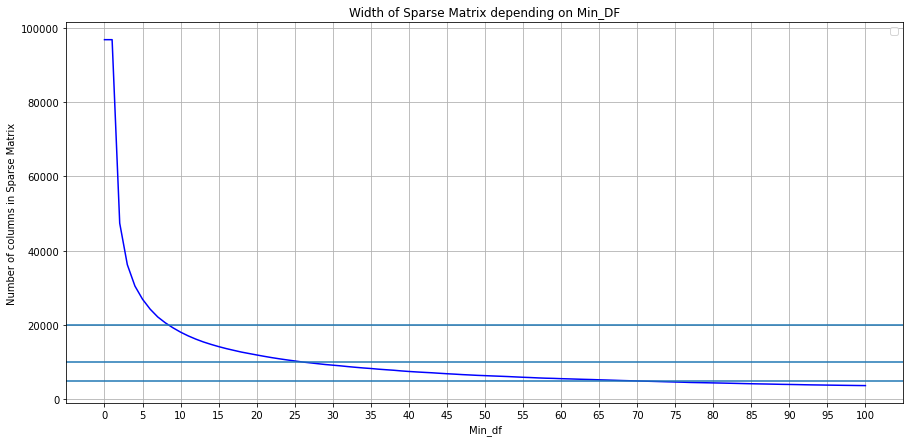

In [14]:
#plotting the results
plt.figure(figsize=(15, 7))
plt.plot(min_df_list, desc_matrix_size, color="blue")
plt.axhline(5000)
plt.axhline(10000)
plt.axhline(20000)
plt.grid()
plt.ylabel("Number of columns in Sparse Matrix")
plt.xlabel("Min_df")
plt.xticks(range(0,101,5))
plt.title('Width of Sparse Matrix depending on Min_DF')
plt.legend()
plt.show()

The curve showing the size of the matric based on the min_df values has a sharp drop between 0 and 5 min_df, then a steady decrease between 5 and 25, then seems to flatten out after that. Therefore, we will pick 25 as the min_df.

In [15]:
#Transform Description with min_df=25

# Instantiate 
bagofwords_desc = CountVectorizer(stop_words="english",min_df=25)

# Fit 
bagofwords_desc.fit(X_train['description'])

# Transform
desc_train_transformed = bagofwords_desc.transform(X_train['description'])
desc_train_transformed

<31231x10274 sparse matrix of type '<class 'numpy.int64'>'
	with 1759504 stored elements in Compressed Sparse Row format>

The size of our matrix has reduced significantly to 10,274 colums, that's much better! We can now try to apply our custom tokenizer that stems the words, to see if it reduces the size further.

In [16]:
#Transform Description with min_df=25 + my_tokenizer

# Instantiate 
bagofwords_desc = CountVectorizer(tokenizer=my_tokenizer,min_df=25)

# Fit 
bagofwords_desc.fit(X_train['description'])

# Transform
desc_train_transformed = bagofwords_desc.transform(X_train['description'])
desc_train_transformed

<31231x7726 sparse matrix of type '<class 'numpy.int64'>'
	with 1896782 stored elements in Compressed Sparse Row format>

It does! That's even a smaller sparse matrix, with 7726 dimensions. We'll go with that. We can now transform the test set on the same count vectorizer model that we fitted on the train data, to avoid data leakage.

In [17]:
#Transforming the test set on the train bagofwords to avoid data leakage
desc_test_transformed = bagofwords_desc.transform(X_test['description'])
desc_test_transformed

<7808x7726 sparse matrix of type '<class 'numpy.int64'>'
	with 470303 stored elements in Compressed Sparse Row format>

Unsurprisingly, it also has 7726 dimensions, that's what we were expecting since it should be the same tokens as the train set. Now that we have turned words into numeric data, we can run our usual data analyses. Let's look at the most common words in the description.

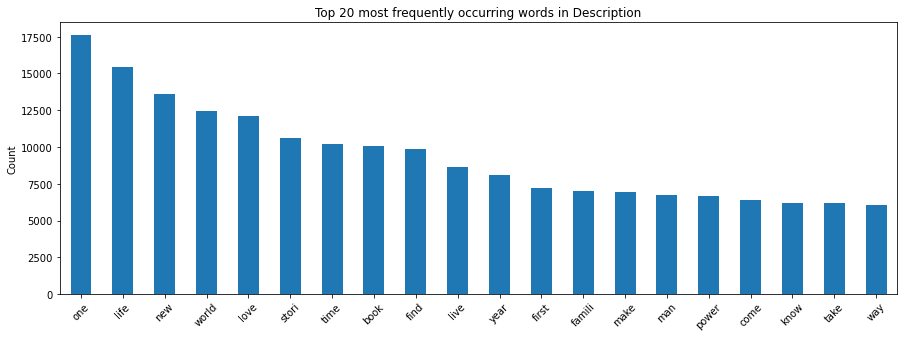

In [18]:
#Plotting the most common words in description
word_counts = pd.DataFrame(
    {"counts": desc_train_transformed.toarray().sum(axis=0)},
    index=bagofwords_desc.get_feature_names()
).sort_values("counts", ascending=False)

word_counts.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in Description")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

This gives us some interesting insights: 'Life' is present 15,000 times in the books' description, we also see 'new', 'world', 'love', story', 'time', 'power' in the most common occurence. Some other words are not as meaningful as they count be in any type of books, like 'one' or..'book'. Just like we've used min_df, we could also exlcude the most occuring words using max_df, but besides the first one, everything else seems to have some meaning and the size of the matrix is reasonable. We'll keep going.

We can now put the description vectors into a dataframe, that we can then merge with the rest of the features. We will add the prefix "d_" in front of the words so we now that they come from the description.

In [19]:
#Putting the description word count into a dataframe; indicating d_ in front of the word for 'description'
desc_train_df = pd.DataFrame(columns=bagofwords_desc.get_feature_names(), data=desc_train_transformed.toarray())
desc_train_df=desc_train_df.add_prefix("d_")
desc_train_df

d_\n  d_1  d_10  d_100  d_1000  d_11  d_12  d_13  d_14  d_15  d_150  \
0         1    0     0      0       0     0     0     0     0     0      0   
1         0    0     0      0       0     0     0     0     0     0      0   
2         0    0     0      0       0     0     0     0     0     0      0   
3         0    0     0      0       0     0     0     0     0     0      0   
4         0    0     0      0       0     0     0     0     0     0      0   
...     ...  ...   ...    ...     ...   ...   ...   ...   ...   ...    ...   
31226     0    0     0      0       0     0     0     0     0     0      0   
31227     0    1     0      0       0     0     0     0     0     0      0   
31228     0    0     0      0       0     0     0     0     0     0      0   
31229     0    0     0      0       0     0     0     0     0     0      0   
31230     0    0     0      0       0     0     0     0     0     0      0   

       d_15yearold  d_16  d_16th  d_16yearold  d_17  d_17yearold  d_18  \
0                0     0       0            0     0            0     0   
1                0     0       0            0     0            0     0   
2                0     0       0            0     0            0     0   
3                0     0       0            0     0            0     0   
4                0     0       0            0     0            0     0   
...            ...   ...     ...          ...   ...          ...   ...   
31226            0     0       0            0     0            0     0   
31227            0     0       0            0     0            0     0   
31228            0     0       0            0     0            0     0   
31229            0     0       0            0     0            0     0   
31230            0     0       0            0     0            0     0   

       d_1800  d_1880  d_1890  d_18th  d_19  d_1900  d_1912  d_1914  d_1917  \
0           0       0       0       0     0       0       0       0       0   
1           0       0       0       0     0       0       0       0       0   
2           0       0       0       0     0       0       0       0       0   
3           0       0       0       0     0       0       0       0       0   
4           0       0       0       0     0       0       0       0       0   
...       ...     ...     ...     ...   ...     ...     ...     ...     ...   
31226       0       0       0       0     0       0       0       0       0   
31227       0       0       0       0     0       0       0       0       0   
31228       0       0       0       0     0       0       0       0       0   
31229       0       0       0       0     0       0       0       0       0   
31230       0       0       0       0     0       0       0       0       0   

       d_1920  d_1922  d_1926  d_1928  d_1929  d_1930  d_1933  d_1934  d_1935  \
0           0       0       0       0       0       0       0       0       0   
1           0       0       0       0       0       0       0       0       0   
2           0       0       0       0       0       0       0       0       0   
3           0       0       0       0       0       0       0       0       0   
4           0       0       0       0       0       0       0       0       0   
...       ...     ...     ...     ...     ...     ...     ...     ...     ...   
31226       0       0       0       0       0       0       0       0       0   
31227       0       0       0       0       0       0       0       0       0   
31228       0       0       0       0       0       0       0       0       0   
31229       0       0       0       0       0       0       0       0       0   
31230       0       0       0       0       0       0       0       0       0   

       d_1936  d_1937  d_1938  d_1939  d_1940  d_1941  d_1942  d_1943  d_1944  \
0           0       0       0       0       0       0       0       0       0   
1           0       0       0       0       0       0       0       0       0   
2           0   

Since the index starts at zero on this new dataframe, we'll have to reset the X_train index to match the description dataframe in order to merge the 2.

In [20]:
#resetting X_train index
X_train.reset_index(drop=True,inplace=True)
X_train

,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year
0,The Radium Girls: The Dark Story of America's ...,\n The incredible true story of the women who...,479,10,0,1,231,1,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,2017
1,The Dark Web Murders,I AM MEMEIN. I AM EMOTIONALLY DETACHED FROM MY...,416,4,1,2,238,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2019
2,I Sold Myself To The Devil For Vinyls... Pitif...,"Lexi Grayson is just a normal teenager, as nor...",421,11,1,1,38,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,2014
3,The Devil Knows You're Dead,"Scudder is back, tracking a killer through the...",338,5,1,14,99,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,1999
4,Chariots of The Gods,Erich von Daniken's Chariots of the Gods is a ...,220,4,0,2,178,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31226,The Legend of Zelda: The Minish Cap,"On the day of the Picori Festival, Link and Pr...",192,7,1,3,86,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,2009
31227,Bits and Pieces: Tales and Sonnets,After demands of thousands of fans in various ...,245,6,0,1,127,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,2013
31228,The Marvellous Land of Snergs,"Located somewhere in ""a world apart,"" just bey...",224,5,0,1,165,0,0,0,1,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,2006
31229,A Dark Kiss of Rapture,"Of all the Fallen, Raze's hungers are some of ...",72,5,1,18,155,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,2011


Both X train and the description dataframe have the same number of rows, and we see that the rows stayed in the same order, so we can merge them safely.

In [21]:
#merging X_Train
X_train_bow=pd.merge(X_train,desc_train_df,left_index=True,right_index=True)
X_train_bow

title  \
0      The Radium Girls: The Dark Story of America's ...   
1                                   The Dark Web Murders   
2      I Sold Myself To The Devil For Vinyls... Pitif...   
3                            The Devil Knows You're Dead   
4                                   Chariots of The Gods   
...                                                  ...   
31226                The Legend of Zelda: The Minish Cap   
31227                 Bits and Pieces: Tales and Sonnets   
31228                      The Marvellous Land of Snergs   
31229                             A Dark Kiss of Rapture   
31230                                         White Fang   

                                             description  pages  \
0      \n  The incredible true story of the women who...    479   
1      I AM MEMEIN. I AM EMOTIONALLY DETACHED FROM MY...    416   
2      Lexi Grayson is just a normal teenager, as nor...    421   
3      Scudder is back, tracking a killer through the...    338   
4      Erich von Daniken's Chariots of the Gods is a ...    220   
...                                                  ...    ...   
31226  On the day of the Picori Festival, Link and Pr...    192   
31227  After demands of thousands of fans in various ...    245   
31228  Located somewhere in "a world apart," just bey...    224   
31229  Of all the Fallen, Raze's hungers are some of ...     72   
31230  White Fang is part dog and part wolf, and the ...    252   

       word_count_title  is_series  book_count_by_author  \
0                    10          0                     1   
1                     4          1                     2   
2                    11          1                     1   
3                     5          1                    14   
4                     4          0                     2   
...                 ...        ...                   ...   
31226                 7          1                     3   
31227                 6          0                     1   
31228                 5          0                     1   
31229                 5          1                    18   
31230                 2          0                    16   

       word_count_description  genre_Adult  genre_Adventure  genre_Biography  \
0                         231            1                0                1   
1                         238            0                0                0   
2                          38            0                0                0   
3                          99            0                0                0   
4                         178            0                0                0   
...                       ...          ...              ...              ...   
31226                      86            0                1                0   
31227                     127            0                0                0   
31228                     165            0                0                0   
31229                     155            0                0                0   
31230                      64            0                1                0   

       genre_Childrens  genre_Classics  genre_Contemporary  genre_Fantasy  \
0                    0               0                   0              0   
1                    0               0                   1              0   
2                    0               0                   1              0   
3                    0               0                   0              0   
4                    0               1                   0              0   
...                ...             ...                 ...            ...   
31226                0               0                   0              1   
31227                0               0                   0              0   
31228                1               1                   0              1   
31229                0               0                   0              1

We can do a quick check: We see that the first row has 1 /n in the description, and the CountVectorizer has the same number. In fact, we should have cleaned up the description to remove the /n as they come from scrapping the data. We'll make a note to do that in our next steps. Let's keep going and do the same thing with the test set to merge it with the rest of the features.

In [22]:
#Putting the test description word count into a dataframe
desc_test_df = pd.DataFrame(columns=bagofwords_desc.get_feature_names(), data=desc_test_transformed.toarray())
desc_test_df=desc_test_df.add_prefix("d_")
desc_test_df

d_\n  d_1  d_10  d_100  d_1000  d_11  d_12  d_13  d_14  d_15  d_150  \
0        0    0     0      0       0     0     0     0     0     0      0   
1        0    0     0      0       0     0     0     0     0     0      0   
2        0    0     0      0       0     0     0     0     0     0      0   
3        0    0     0      0       0     0     0     0     0     0      0   
4        0    0     0      0       0     0     0     0     0     0      0   
...    ...  ...   ...    ...     ...   ...   ...   ...   ...   ...    ...   
7803     0    0     0      0       0     0     0     0     0     0      0   
7804     0    0     0      0       0     0     0     0     0     0      0   
7805     0    0     0      0       0     0     0     0     0     0      0   
7806     0    0     0      0       0     0     0     0     0     0      0   
7807     0    0     0      0       0     0     0     0     0     0      0   

      d_15yearold  d_16  d_16th  d_16yearold  d_17  d_17yearold  d_18  d_1800  \
0               0     0       0            0     0            0     0       0   
1               0     0       0            0     0            0     0       0   
2               0     0       0            0     0            0     0       0   
3               0     0       0            0     0            0     0       0   
4               0     0       0            0     0            0     0       0   
...           ...   ...     ...          ...   ...          ...   ...     ...   
7803            0     0       0            0     0            0     0       0   
7804            0     0       0            0     0            0     0       0   
7805            0     0       0            0     0            0     0       0   
7806            0     0       0            0     0            0     0       0   
7807            0     0       0            0     0            0     0       0   

      d_1880  d_1890  d_18th  d_19  d_1900  d_1912  d_1914  d_1917  d_1920  \
0          0       0       0     0       0       0       0       0       0   
1          0       0       0     0       0       0       0       0       0   
2          0       0       0     0       0       0       0       0       0   
3          0       0       0     0       0       0       0       0       0   
4          0       0       0     0       0       0       0       0       0   
...      ...     ...     ...   ...     ...     ...     ...     ...     ...   
7803       0       0       0     0       0       0       0       0       0   
7804       0       0       0     0       0       0       0       0       0   
7805       0       0       0     0       0       0       0       0       0   
7806       0       0       0     0       0       0       0       0       0   
7807       0       0       0     0       0       0       0       0       0   

      d_1922  d_1926  d_1928  d_1929  d_1930  d_1933  d_1934  d_1935  d_1936  \
0          0       0       0       0       0       0       0       0       0   
1          0       0       0       0       0       0       0       0       0   
2          0       0       0       0       0       0       0       0       0   
3          0       0       0       0       0       0       0       0       0   
4          0       0       0       0       0       0       0       0       0   
...      ...     ...     ...     ...     ...     ...     ...     ...     ...   
7803       0       0       0       0       0       0       0       0       0   
7804       0       0       0       0       0       0       0       0       0   
7805       0       0       0       0       0       0       0       0       0   
7806       0       0       0       0       0       0       0       0       0   
7807       0       0       0       0       0       0       0       0       0   

      d_1937  d_1938  d_1939  d_1940  d_1941  d_1942  d_1943  d_1944  d_1945  \
0          0       0       0       0       0       0       0       0       0   
1          0       0       0       0       0      

In [23]:
#resetting X_test index
X_test.reset_index(drop=True,inplace=True)
X_test

,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year
0,Legends over Generations,"Since the beginning of human settlement, a lot...",228,3,0,1,188,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2018
1,Kiss of Fate,One foretold love deserves a second chance…Hau...,396,3,1,8,174,1,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,2009
2,Man Is Not Alone: A Philosophy of Religion,"Man Is Not Alone is a profound, beautifully wr...",320,8,0,2,118,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1976
3,A Highlander Christmas,Camry MacKeage has absolutely no intention of ...,334,3,1,9,104,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,2009
4,The Mistletoe Bride & Other Haunting Tales,A wonderfully atmospheric collection of storie...,304,7,0,4,85,0,0,0,0,0,0,1,1,1,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7803,"Savage Dragon, Vol. 1: Baptism of Fire",(W/A) Erik Larsen Chicago. A criminal mastermi...,160,7,1,1,64,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,2002
7804,Unsouled,Sacred artists follow a thousand Paths to powe...,294,1,1,4,50,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,2016
7805,Life and Fate,Life and Fate is an epic tale of a country tol...,864,3,1,2,86,0,0,0,0,1,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,1,2006
7806,If We Were Villains,Oliver Marks has just served ten years in jail...,368,4,0,1,125,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,2017


Both our test set and description dataframe have 7808 rows. Let's merge them.

In [24]:
#merging X_Test
X_test_bow=pd.merge(X_test,desc_test_df,left_index=True,right_index=True)
X_test_bow

title  \
0                       Legends over Generations   
1                                   Kiss of Fate   
2     Man Is Not Alone: A Philosophy of Religion   
3                         A Highlander Christmas   
4     The Mistletoe Bride & Other Haunting Tales   
...                                          ...   
7803      Savage Dragon, Vol. 1: Baptism of Fire   
7804                                    Unsouled   
7805                               Life and Fate   
7806                         If We Were Villains   
7807                          Stag's Leap: Poems   

                                            description  pages  \
0     Since the beginning of human settlement, a lot...    228   
1     One foretold love deserves a second chance…Hau...    396   
2     Man Is Not Alone is a profound, beautifully wr...    320   
3     Camry MacKeage has absolutely no intention of ...    334   
4     A wonderfully atmospheric collection of storie...    304   
...                                                 ...    ...   
7803  (W/A) Erik Larsen Chicago. A criminal mastermi...    160   
7804  Sacred artists follow a thousand Paths to powe...    294   
7805  Life and Fate is an epic tale of a country tol...    864   
7806  Oliver Marks has just served ten years in jail...    368   
7807  Stag’s Leap is stunningly poignant sequence of...    112   

      word_count_title  is_series  book_count_by_author  \
0                    3          0                     1   
1                    3          1                     8   
2                    8          0                     2   
3                    3          1                     9   
4                    7          0                     4   
...                ...        ...                   ...   
7803                 7          1                     1   
7804                 1          1                     4   
7805                 3          1                     2   
7806                 4          0                     1   
7807                 3          0                     2   

      word_count_description  genre_Adult  genre_Adventure  genre_Biography  \
0                        188            0                0                1   
1                        174            1                0                0   
2                        118            0                0                0   
3                        104            0                0                0   
4                         85            0                0                0   
...                      ...          ...              ...              ...   
7803                      64            0                1                0   
7804                      50            0                1                0   
7805                      86            0                0                0   
7806                     125            1                0                0   
7807                     204            1                0                0   

      genre_Childrens  genre_Classics  genre_Contemporary  genre_Fantasy  \
0                   0               0                   0              0   
1                   0               0                   0              1   
2                   0               0                   0              0   
3                   0               0                   1              1   
4                   0               0                   0              1   
...               ...             ...                 ...            ...   
7803                0               0                   0              0   
7804                0               0                   0              1   
7805                0               1                   0              0   
7806                0               0                   1              0   
7807                0               0                   1              0   

      genre_Fiction  genre_Historical  genre_Historica

We have now converted the description into word vectors, and created a new X that includes those word counts. We follow the exact same steps to convert the title as well.

## 1.3 Converting Title

First we instantiate and fit a CountVectorizer model, then transform the title.

In [25]:
#Transform Title

# Instantiate 
bagofwords_title = CountVectorizer(stop_words="english")

# Fit 
bagofwords_title.fit(X_train['title'])

# Transform
title_train_transformed = bagofwords_title.transform(X_train['title'])
title_train_transformed

<31231x17840 sparse matrix of type '<class 'numpy.int64'>'
	with 81129 stored elements in Compressed Sparse Row format>

The sparse matrix is smaller than for the description, which is normal since titles don't have as many words as descriptions. Still, 17,860 columns is a lot! Again, we'll try to fin the best min_df for our model.

In [26]:
#Looping over min_df to see the impact on the matrix size
#Using the default tokenizer instead of my_tokenizer as run time would be too long

min_df_list=range(0,101)
title_matrix_size=[]

for i in min_df_list:

    # Instantiate 
    bagofwords_title = CountVectorizer(stop_words="english",min_df=i)

    # Fit 
    bagofwords_title.fit(X_train['title'])

    # Transform
    title_train_transformed = bagofwords_title.transform(X_train['title'])
    title_train_transformed
    
    #Appending the list
    title_matrix_size.append(title_train_transformed.shape[1])

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


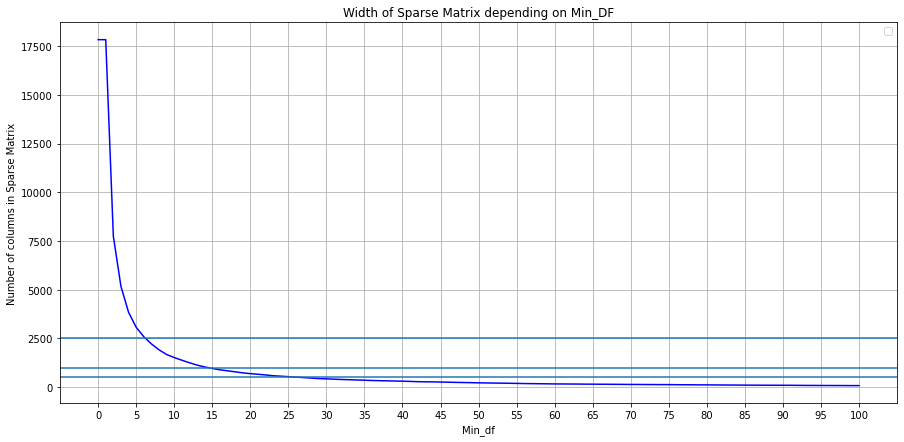

In [27]:
#plotting the results
plt.figure(figsize=(15, 7))
plt.plot(min_df_list, title_matrix_size, color="blue")
plt.axhline(2500)
plt.axhline(1000)
plt.axhline(500)
plt.grid()
plt.ylabel("Number of columns in Sparse Matrix")
plt.xlabel("Min_df")
plt.xticks(range(0,101,5))
plt.title('Width of Sparse Matrix depending on Min_DF')
plt.legend()
plt.show()

We see a sharp elbow curve again, this time the line starts flattening out around 15, so we will chose this value for the next iteration of the model.

In [28]:
#Transform Description with min_df=15

# Instantiate 
bagofwords_title = CountVectorizer(stop_words="english",min_df=15)

# Fit 
bagofwords_title.fit(X_train['title'])

# Transform
title_train_transformed = bagofwords_title.transform(X_train['title'])
title_train_transformed

<31231x957 sparse matrix of type '<class 'numpy.int64'>'
	with 42169 stored elements in Compressed Sparse Row format>

The size of the matrix has reduced significantly to 957 columns, that much more manageable. Let's use our custome tokenizer again to see if it reduces the size even further.

In [29]:
#Transform Description with min_df=15 + my_tokenizer

# Instantiate 
bagofwords_title = CountVectorizer(tokenizer=my_tokenizer,min_df=15)

# Fit 
bagofwords_title.fit(X_train['title'])

# Transform
title_train_transformed = bagofwords_title.transform(X_train['title'])
title_train_transformed

<31231x1089 sparse matrix of type '<class 'numpy.int64'>'
	with 53070 stored elements in Compressed Sparse Row format>

For some reason, the customer tokenizer gave us a bigger matrix than the built-in stop words. For consistency with the way we transformed the description, and since the difference between the 2 matrices is not that big, we'll keep this result. We can now transform the test set on the train bag of words.

In [30]:
#Transforming the test set on the train bagofwords
title_test_transformed = bagofwords_title.transform(X_test['title'])
title_test_transformed

<7808x1089 sparse matrix of type '<class 'numpy.int64'>'
	with 13062 stored elements in Compressed Sparse Row format>

We have the same number of columns as in the train set, 1089 which is what we wanted to see. Next, we can do the same as with description and plot the most common words in the books titles.

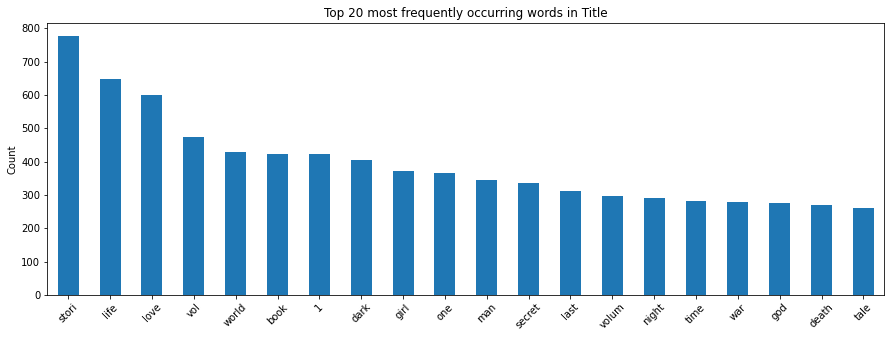

In [31]:
#Plotting the most common words in title
word_counts_title = pd.DataFrame(
    {"counts": title_train_transformed.toarray().sum(axis=0)},
    index=bagofwords_title.get_feature_names()
).sort_values("counts", ascending=False)

word_counts_title.head(20).plot(kind="bar", figsize=(15, 5), legend=False)
plt.title("Top 20 most frequently occurring words in Title")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()

Interesting, we see that some of the words that occured frenquently in the description also occur frequently in the title: 'story', 'life', 'love', 'world'. We also see some new and intriguing words: 'girl', 'secret', 'night', 'war'. 

Next, we put the title word count into a dataframe and merge it with the rest of the features, including the description word count. We put a "t_" in front of the word this time to indicates that it comes from the title.

In [32]:
#Putting the title word count into a dataframe; indicating t_ in front of the word for 'title'
title_train_df = pd.DataFrame(columns=bagofwords_title.get_feature_names(), data=title_train_transformed.toarray())
title_train_df=title_train_df.add_prefix("t_")
title_train_df

t_01  t_1  t_10  t_100  t_101  t_12  t_13  t_14  t_15  t_2  t_3  t_4  \
0         0    0     0      0      0     0     0     0     0    0    0    0   
1         0    0     0      0      0     0     0     0     0    0    0    0   
2         0    0     0      0      0     0     0     0     0    0    0    0   
3         0    0     0      0      0     0     0     0     0    0    0    0   
4         0    0     0      0      0     0     0     0     0    0    0    0   
...     ...  ...   ...    ...    ...   ...   ...   ...   ...  ...  ...  ...   
31226     0    0     0      0      0     0     0     0     0    0    0    0   
31227     0    0     0      0      0     0     0     0     0    0    0    0   
31228     0    0     0      0      0     0     0     0     0    0    0    0   
31229     0    0     0      0      0     0     0     0     0    0    0    0   
31230     0    0     0      0      0     0     0     0     0    0    0    0   

       t_5  t_6  t_7  t_8  t_9  t_absolut  t_academi  t_accident  t_accord  \
0        0    0    0    0    0          0          0           0         0   
1        0    0    0    0    0          0          0           0         0   
2        0    0    0    0    0          0          0           0         0   
3        0    0    0    0    0          0          0           0         0   
4        0    0    0    0    0          0          0           0         0   
...    ...  ...  ...  ...  ...        ...        ...         ...       ...   
31226    0    0    0    0    0          0          0           0         0   
31227    0    0    0    0    0          0          0           0         0   
31228    0    0    0    0    0          0          0           0         0   
31229    0    0    0    0    0          0          0           0         0   
31230    0    0    0    0    0          0          0           0         0   

       t_account  t_across  t_act  t_adam  t_adventur  t_affair  t_africa  \
0              0         0      0       0           0         0         0   
1              0         0      0       0           0         0         0   
2              0         0      0       0           0         0         0   
3              0         0      0       0           0         0         0   
4              0         0      0       0           0         0         0   
...          ...       ...    ...     ...         ...       ...       ...   
31226          0         0      0       0           0         0         0   
31227          0         0      0       0           0         0         0   
31228          0         0      0       0           0         0         0   
31229          0         0      0       0           0         0         0   
31230          0         0      0       0           0         0         0   

       t_age  t_agent  t_air  t_akiko  t_alic  t_alien  t_aliv  t_almost  \
0          0        0      0        0       0        0       0         0   
1          0        0      0        0       0        0       0         0   
2          0        0      0        0       0        0       0         0   
3          0        0      0        0       0        0       0         0   
4          0        0      0        0       0        0       0         0   
...      ...      ...    ...      ...     ...      ...     ...       ...   
31226      0        0      0        0       0        0       0         0   
31227      0        0      0        0       0        0       0         0   
31228      0        0      0        0       0        0       0         0   
31229      0        0      0        0       0        0       0         0   
31230      0        0      0        0       0        0       0         0   

       t_alon  t_alpha  t_alway  t_amaz  t_amber  t_america  t_american  \
0           0        0        0       0        0          1           0   
1           0        0        0       0        0          0           0   
2           0        0        0       0        0          

In [33]:
#Check that title_train_df and train set have the same number of rows
title_train_df.shape[0]-X_train_bow.shape[0]
#should be 0

0

In [34]:
#merging X_Train
X_train_bow=pd.merge(X_train_bow,title_train_df,left_index=True,right_index=True)
X_train_bow.head()

,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year,d_\n,d_1,d_10,d_100,d_1000,d_11,d_12,d_13,d_14,d_15,d_150,d_15yearold,d_16,d_16th,d_16yearold,d_17,d_17yearold,d_18,d_1800,d_1880,d_1890,d_18th,d_19,d_1900,d_1912,d_1914,d_1917,d_1920,d_1922,d_1926,d_1928,d_1929,d_1930,d_1933,d_1934,d_1935,d_1936,d_1937,d_1938,d_1939,d_1940,d_1941,d_1942,d_1943,d_1944,d_1945,d_1946,d_1947,d_1948,d_1950,d_1951,d_1952,d_1953,d_1954,d_1955,d_1956,d_1957,d_1958,d_1959,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969,d_1970,d_1971,d_1972,d_1973,d_1974,d_1975,d_1976,d_1977,d_1978,d_1979,d_1980,d_1981,d_1982,d_1983,d_1984,d_1985,d_1986,d_1987,d_1988,d_1989,d_1990,d_1991,d_1992,d_1993,d_1994,d_1995,d_1996,d_1997,d_1998,d_1999,d_19th,d_19thcenturi,d_1st,d_2,d_20,d_200,d_2000,d_2001,d_2002,d_2003,d_2004,d_2005,d_2006,d_2007,d_2008,d_2009,d_2010,d_2011,d_2012,d_2013,d_2014,d_2015,d_2016,d_20th,d_20thcenturi,d_21,d_21st,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_3,d_30,d_300,d_31,d_35,d_39,d_4,d_40,d_400,d_45,d_5,d_50,d_500,d_6,d_60,d_7,d_70,d_8,d_80,d_9,d_90,d_911,d_aaron,d_abandon,d_abbey,d_abbi,d_abbott,d_abduct,d_abid,d_abigail,d_abil,d_abl,d_aboard,d_abomin,d_abort,d_abound,d_abraham,d_abridg,d_abroad,d_abruptli,d_absenc,d_absent,d_absolut,d_absorb,d_abstract,d_absurd,d_abund,d_abus,d_abyss,d_academ,d_academi,d_acceler,d_accent,d_accept,d_access,d_accid,d_accident,d_acclaim,d_accompani,d_accomplish,d_accord,d_account,d_accumul,d_accur,d_accuraci,d_accus,d_accustom,d_ace,d_ach,d_achiev,d_achingli,d_acid,d_acknowledg,d_acquaint,d_acquir,d_acr,d_across,d_act,d_action,d_actionpack,d_activ,d_activist,d_actor,d_actress,d_actual,d_acut,d_ad,d_adam,d_adapt,d_add,d_addi,d_addict,d_addit,d_address,d_adept,d_adher,d_adjust,d_administr,d_admir,d_admit,d_adolesc,d_adolf,d_adopt,d_ador,d_adrian,d_adrift,d_adult,d_adulteri,d_adulthood,d_advanc,d_advantag,d_adventur,d_advers,d_adversari,d_advertis,d_advic,d_advis,d_advisor,d_advoc,d_aesthet,d_afar,d_affair,d_affect,d_affection,d_affirm,d_afflict,d_affluent,d_afford,d_afghanistan,d_afloat,d_afraid,d_africa,d_african,d_africanamerican,d_afterlif,d_aftermath,d_afternoon,d_afterward,d_afterword,d_againa,d_agatha,d_age,d_ageless,d_agenc,d_agenda,d_agent,d_ageold,d_aggress,d_ago,d_agon,d_agoni,d_agre,d_agreement,d_ahead,d_aid,d_aidan,d_aiden,d_ail,d_aim,d_air,d_airlin,d_airplan,d_airport,d_aisl,d_aka,d_al,d_ala,d_alabama,d_alan,d_alarm,d_alaska,d_alaskan,d_albert,d_album,d_alchemi,d_alchemist,d_alcohol,d_alec,d_alert,d_alex,d_alexa,d_alexand,d_alexandra,d_alexandria,d_alexi,d_alfr,d_ali,d_alic,d_alien,d_align,d_alik,d_alison,d_alist,d_aliv,d_allamerican,d_allan,d_allconsum,d_alleg,d_allegi,d_allegori,d_allen,d_alley,d_alli,d_allianc,d_allison,d_allnew,d_allout,d_allow,d_allpow,d_alltim,d_allur,d_allus,d_almost,d_alon,d_along,d_alongsid,d_aloof,d_aloud,d_alp,d_alpha,d_alphabet,d_alreadi,d_also,d_altar,d_alter,d_altern,d_although,d_altogeth,d_alway,d_amanda,d_amass,d_amateur,d_amaz,d_amazon,d_ambassador,d_amber,d_ambigu,d_ambit,d_ambiti,d_ambush,d_amelia,d_amend,d_america,d_american,d_america’,d_ami,d_amid,d_amidst,d_amish,d_amnesia,d_among,d_amongst,d_amor,d_amount,d_amsterdam,d_amus,d_anakin,d_analys,d_analysi,d_analyst,d_analyt,d_analyz,d_anarchi,d_anarchist,d_anatomi,d_ancestor,d_ancestr,d_anchor,d_ancient,d_anderson,d_andi,d_andr,d_andrea,d_andrew,d_android,d_anecdot,d_anew,d_angel,d_angela,d_anger,d_angl,d_angri,d_angst,d_anguish,d_anim,d_anita,d_ann,d_

We can do a sanity check on a random row to see which words have been picked up from the title and description.

In [35]:
#Sanity Check - see what words are counted for row 3 (index 2)
check_df=X_train_bow.iloc[2,:].to_frame().rename(columns={2:"attributes"})

#Expanding the column width
pd.options.display.max_colwidth=100

#filtering for word count not zero
check_df[check_df['attributes']!=0]

,attributes
title,I Sold Myself To The Devil For Vinyls... Pitiful I Know
description,"Lexi Grayson is just a normal teenager, as normal as she can be with her unobserving skills and ..."
pages,421
word_count_title,11
is_series,1
book_count_by_author,1
word_count_description,38
genre_Contemporary,1
genre_Romance,1
genre_Young Adult,1


For row 3, 'I Sold Myself to the Devil for Vinyls... Pitiful I know', we see that the word count only kept 'devil' and 'know' from the vectorization of the title; and we find 'normal', 'teenager', 'mystery' in the vectorization of the description. It looks right. We'll do the same thing for the test set.

In [36]:
#Putting the test description word count into a dataframe
title_test_df = pd.DataFrame(columns=bagofwords_title.get_feature_names(), data=title_test_transformed.toarray())
title_test_df=title_test_df.add_prefix("t_")
title_test_df

t_01  t_1  t_10  t_100  t_101  t_12  t_13  t_14  t_15  t_2  t_3  t_4  \
0        0    0     0      0      0     0     0     0     0    0    0    0   
1        0    0     0      0      0     0     0     0     0    0    0    0   
2        0    0     0      0      0     0     0     0     0    0    0    0   
3        0    0     0      0      0     0     0     0     0    0    0    0   
4        0    0     0      0      0     0     0     0     0    0    0    0   
...    ...  ...   ...    ...    ...   ...   ...   ...   ...  ...  ...  ...   
7803     0    1     0      0      0     0     0     0     0    0    0    0   
7804     0    0     0      0      0     0     0     0     0    0    0    0   
7805     0    0     0      0      0     0     0     0     0    0    0    0   
7806     0    0     0      0      0     0     0     0     0    0    0    0   
7807     0    0     0      0      0     0     0     0     0    0    0    0   

      t_5  t_6  t_7  t_8  t_9  t_absolut  t_academi  t_accident  t_accord  \
0       0    0    0    0    0          0          0           0         0   
1       0    0    0    0    0          0          0           0         0   
2       0    0    0    0    0          0          0           0         0   
3       0    0    0    0    0          0          0           0         0   
4       0    0    0    0    0          0          0           0         0   
...   ...  ...  ...  ...  ...        ...        ...         ...       ...   
7803    0    0    0    0    0          0          0           0         0   
7804    0    0    0    0    0          0          0           0         0   
7805    0    0    0    0    0          0          0           0         0   
7806    0    0    0    0    0          0          0           0         0   
7807    0    0    0    0    0          0          0           0         0   

      t_account  t_across  t_act  t_adam  t_adventur  t_affair  t_africa  \
0             0         0      0       0           0         0         0   
1             0         0      0       0           0         0         0   
2             0         0      0       0           0         0         0   
3             0         0      0       0           0         0         0   
4             0         0      0       0           0         0         0   
...         ...       ...    ...     ...         ...       ...       ...   
7803          0         0      0       0           0         0         0   
7804          0         0      0       0           0         0         0   
7805          0         0      0       0           0         0         0   
7806          0         0      0       0           0         0         0   
7807          0         0      0       0           0         0         0   

      t_age  t_agent  t_air  t_akiko  t_alic  t_alien  t_aliv  t_almost  \
0         0        0      0        0       0        0       0         0   
1         0        0      0        0       0        0       0         0   
2         0        0      0        0       0        0       0         0   
3         0        0      0        0       0        0       0         0   
4         0        0      0        0       0        0       0         0   
...     ...      ...    ...      ...     ...      ...     ...       ...   
7803      0        0      0        0       0        0       0         0   
7804      0        0      0        0       0        0       0         0   
7805      0        0      0        0       0        0       0         0   
7806      0        0      0        0       0        0       0         0   
7807      0        0      0        0       0        0       0         0   

      t_alon  t_alpha  t_alway  t_amaz  t_amber  t_america  t_american  \
0          0        0        0       0        0          0           0   
1          0        0        0       0        0          0           0   
2          1        0        0       0        0          0           0   
3          0        0        0    

In [37]:
#merging X_Test
X_test_bow=pd.merge(X_test_bow,title_test_df,left_index=True,right_index=True)
X_test_bow.head(5)

,title,description,pages,word_count_title,is_series,book_count_by_author,word_count_description,genre_Adult,genre_Adventure,genre_Biography,genre_Childrens,genre_Classics,genre_Contemporary,genre_Fantasy,genre_Fiction,genre_Historical,genre_Historical Fiction,genre_History,genre_Horror,genre_Islam,genre_Literature,genre_Magic,genre_Mystery,genre_Nonfiction,genre_Novels,genre_Paranormal,genre_Poetry,genre_Romance,genre_Science Fiction,genre_Thriller,genre_Urban,genre_Young Adult,genre_Other,format_Audiobook,format_Hardcover,format_Mass Market Paperback,format_Paperback,format_ebook,has_awards,publish_year,d_\n,d_1,d_10,d_100,d_1000,d_11,d_12,d_13,d_14,d_15,d_150,d_15yearold,d_16,d_16th,d_16yearold,d_17,d_17yearold,d_18,d_1800,d_1880,d_1890,d_18th,d_19,d_1900,d_1912,d_1914,d_1917,d_1920,d_1922,d_1926,d_1928,d_1929,d_1930,d_1933,d_1934,d_1935,d_1936,d_1937,d_1938,d_1939,d_1940,d_1941,d_1942,d_1943,d_1944,d_1945,d_1946,d_1947,d_1948,d_1950,d_1951,d_1952,d_1953,d_1954,d_1955,d_1956,d_1957,d_1958,d_1959,d_1960,d_1961,d_1962,d_1963,d_1964,d_1965,d_1966,d_1967,d_1968,d_1969,d_1970,d_1971,d_1972,d_1973,d_1974,d_1975,d_1976,d_1977,d_1978,d_1979,d_1980,d_1981,d_1982,d_1983,d_1984,d_1985,d_1986,d_1987,d_1988,d_1989,d_1990,d_1991,d_1992,d_1993,d_1994,d_1995,d_1996,d_1997,d_1998,d_1999,d_19th,d_19thcenturi,d_1st,d_2,d_20,d_200,d_2000,d_2001,d_2002,d_2003,d_2004,d_2005,d_2006,d_2007,d_2008,d_2009,d_2010,d_2011,d_2012,d_2013,d_2014,d_2015,d_2016,d_20th,d_20thcenturi,d_21,d_21st,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_3,d_30,d_300,d_31,d_35,d_39,d_4,d_40,d_400,d_45,d_5,d_50,d_500,d_6,d_60,d_7,d_70,d_8,d_80,d_9,d_90,d_911,d_aaron,d_abandon,d_abbey,d_abbi,d_abbott,d_abduct,d_abid,d_abigail,d_abil,d_abl,d_aboard,d_abomin,d_abort,d_abound,d_abraham,d_abridg,d_abroad,d_abruptli,d_absenc,d_absent,d_absolut,d_absorb,d_abstract,d_absurd,d_abund,d_abus,d_abyss,d_academ,d_academi,d_acceler,d_accent,d_accept,d_access,d_accid,d_accident,d_acclaim,d_accompani,d_accomplish,d_accord,d_account,d_accumul,d_accur,d_accuraci,d_accus,d_accustom,d_ace,d_ach,d_achiev,d_achingli,d_acid,d_acknowledg,d_acquaint,d_acquir,d_acr,d_across,d_act,d_action,d_actionpack,d_activ,d_activist,d_actor,d_actress,d_actual,d_acut,d_ad,d_adam,d_adapt,d_add,d_addi,d_addict,d_addit,d_address,d_adept,d_adher,d_adjust,d_administr,d_admir,d_admit,d_adolesc,d_adolf,d_adopt,d_ador,d_adrian,d_adrift,d_adult,d_adulteri,d_adulthood,d_advanc,d_advantag,d_adventur,d_advers,d_adversari,d_advertis,d_advic,d_advis,d_advisor,d_advoc,d_aesthet,d_afar,d_affair,d_affect,d_affection,d_affirm,d_afflict,d_affluent,d_afford,d_afghanistan,d_afloat,d_afraid,d_africa,d_african,d_africanamerican,d_afterlif,d_aftermath,d_afternoon,d_afterward,d_afterword,d_againa,d_agatha,d_age,d_ageless,d_agenc,d_agenda,d_agent,d_ageold,d_aggress,d_ago,d_agon,d_agoni,d_agre,d_agreement,d_ahead,d_aid,d_aidan,d_aiden,d_ail,d_aim,d_air,d_airlin,d_airplan,d_airport,d_aisl,d_aka,d_al,d_ala,d_alabama,d_alan,d_alarm,d_alaska,d_alaskan,d_albert,d_album,d_alchemi,d_alchemist,d_alcohol,d_alec,d_alert,d_alex,d_alexa,d_alexand,d_alexandra,d_alexandria,d_alexi,d_alfr,d_ali,d_alic,d_alien,d_align,d_alik,d_alison,d_alist,d_aliv,d_allamerican,d_allan,d_allconsum,d_alleg,d_allegi,d_allegori,d_allen,d_alley,d_alli,d_allianc,d_allison,d_allnew,d_allout,d_allow,d_allpow,d_alltim,d_allur,d_allus,d_almost,d_alon,d_along,d_alongsid,d_aloof,d_aloud,d_alp,d_alpha,d_alphabet,d_alreadi,d_also,d_altar,d_alter,d_altern,d_although,d_altogeth,d_alway,d_amanda,d_amass,d_amateur,d_amaz,d_amazon,d_ambassador,d_amber,d_ambigu,d_ambit,d_ambiti,d_ambush,d_amelia,d_amend,d_america,d_american,d_america’,d_ami,d_amid,d_amidst,d_amish,d_amnesia,d_among,d_amongst,d_amor,d_amount,d_amsterdam,d_amus,d_anakin,d_analys,d_analysi,d_analyst,d_analyt,d_analyz,d_anarchi,d_anarchist,d_anatomi,d_ancestor,d_ancestr,d_anchor,d_ancient,d_anderson,d_andi,d_andr,d_andrea,d_andrew,d_android,d_anecdot,d_anew,d_angel,d_angela,d_anger,d_angl,d_angri,d_angst,d_anguish,d_anim,d_anita,d_ann,d_

In [38]:
#Sanity Check - see what words are counted for row 4 (index 3)
check_df_test=X_test_bow.iloc[3,:].to_frame().rename(columns={3:"attributes"})

#Filtering out the zeros
check_df_test[check_df_test['attributes']!=0]

,attributes
title,A Highlander Christmas
description,Camry MacKeage has absolutely no intention of telling her parents that she left her job as a NAS...
pages,334
word_count_title,3
is_series,1
...,...
d_way,1
d_whole,1
d_winter,1
t_christma,1


For 'A Highlander Christmas' we see that the tile word count has picked up 'christmas' and 'highlander', and that the description word count has 'parents', 'job' and 'nasa'. This seems right.

## 1.4 Logistic Regression on BOW

Let's now run a simple LR to see if the model performs better. First we have to drop the text columns from train and test.

In [39]:
#Dropping Description and Title from X Train
X_train_bow.drop(['title','description'],axis=1,inplace=True)
X_test_bow.drop(['title','description'],axis=1,inplace=True)

Next, we set up a pipeline with a RobustScaler and C=0.001, the same as in Part 2, to get a first idea of the model's performance. We'll tune the hyperparameters in the following step.

In [40]:
#Instantiate a basic LR model with a Robust Scaler

# define steps with the specified objects and parameters
estimators = [
    ('robust_scaler',RobustScaler()),
    ('lr', LogisticRegression(C=0.001,random_state=1))
]

# create pipeline object
pipe = Pipeline(estimators);

# fit the pipeline to the untransformed training data
pipe.fit(X_train_bow, y_train);

# accuracy scores
print(f'Train accuracy: {pipe.score(X_train_bow, y_train)}')
print(f'Test accuracy: {pipe.score(X_test_bow, y_test)}')

train accuracy: 0.6914283884601838
test accuracy: 0.6609887295081968


The test set scored an accuracy of 66.1%, that's better than the Logistic Regression scores we had earlier (our best LR score was 63.7%) We will now set up a full pipeline with cross validation to figure out the best parameters.

### 1.4.1 Pipeline for LR

Since pipelines are computationally expensive, we will split our X_train_bow set to keep only 20% of it, and run the pipeline on this subset of data.

In [41]:
# Split the X_train_bow to train and val set
X_train_bow_small, X_val_bow_small, y_train_small, y_val_small= train_test_split (X_train_bow, y_train, test_size=0.8, stratify=y_train, random_state=1)

In [42]:
#Shape of the subset of X
X_train_bow_small.shape

(6246, 8853)

In [43]:
#Shape of the subset of y
y_train_small.shape

(6246,)

Our subset of X and y have 6,246 rows, a much smaller size than earlier. We can also check that the proportion have been preserved through the stratify argument.

In [44]:
#Check that the class proportion have been preserved
print('Proportions in original data:')
print(y.value_counts()/len(y), '\n')

print('Proportions in remainder set:')
print(y_train_small.value_counts()/len(y_train_small), '\n')

print('Proportions in test set:')
print(y_val_small.value_counts()/len(y_val_small), '\n')

Proportions in original data:
1    0.515664
0    0.484336
Name: is_popular, dtype: float64 

Proportions in remainder set:
1    0.51569
0    0.48431
Name: is_popular, dtype: float64 

Proportions in test set:
1    0.515669
0    0.484331
Name: is_popular, dtype: float64 



The proportions look good, still 52/48 as expected. We will now set up the pipeline.

Note: Since this step takes a long time to run, we have changed the code cells to markdown cells. When we are ready to run it, we can change the cells back to code.

We will set up a pipeline with the following parameters:
- C values = 0.001,0.01,0.1,1,10,100
- No PCA or PCA =0.9
- No Scaler, Standard Scaler, MinMax Scaler and Robust Scaler
- Penalty = l1 or l2


#### This next step takes a long time to run. Change the cells to code when ready to run it

#Set up a directory to cache the pipeline results
cachedir = mkdtemp()

#Set up a pipeline
my_pipeline = Pipeline([('scaler', StandardScaler()), 
                        ('dim_reducer', PCA()), 
                        ('model', LogisticRegression())], memory=cachedir)

#Defining several C values
c_values = [0.001,0.01,0.1,1,10,100,]

#Parameter grid
logreg_param_grid = [
    
    # l1 without PCA
    {'scaler': [None, StandardScaler(), MinMaxScaler(), RobustScaler()],
     'dim_reducer': [None],
     'model': [LogisticRegression(max_iter=1000,penalty='l1', random_state=1, n_jobs=-1)],
     'model__C': c_values},
    
    # l1 with PCA
    {'scaler': [None, StandardScaler(), MinMaxScaler(), RobustScaler()],
     'dim_reducer': [PCA()],
     'dim_reducer__n_components': [0.9],
     'model': [LogisticRegression(max_iter=1000,penalty='l1', random_state=1, n_jobs=-1)],
     'model__C': c_values},
    
    # l2 without PCA
    {'scaler': [None, StandardScaler(), MinMaxScaler(), RobustScaler()],
     'dim_reducer': [None],
     'model': [LogisticRegression(max_iter=1000,solver='lbfgs', random_state=1, n_jobs=-1)],
     'model__C': c_values},
    
    # l2 with PCA
    {'scaler': [None, StandardScaler(), MinMaxScaler(), RobustScaler()],
     'dim_reducer': [PCA()],
     'dim_reducer__n_components': [0.9],
     'model': [LogisticRegression(max_iter=1000,solver='lbfgs', random_state=1, n_jobs=-1)],
     'model__C': c_values}
]

#instantiate cross-validated grid search object with the steps and parameter grid
grid = GridSearchCV(my_pipeline, param_grid = logreg_param_grid, cv = 5, verbose = 5, n_jobs = -1)

#Fit the grid to unprocessed train data
grid.fit(X_train_bow_small, y_train_small)

#check the most optimal model
grid.best_estimator_

The best model was RobustScaler, C=0.01, no PCA. We will instantiate this model on the full Train set now.

In [45]:
#Instantiate the best LR model on the full Train set

# define steps with the specified objects and parameters
estimators = [
    ('scaler',RobustScaler()),
    ('lr', LogisticRegression(C=0.01, max_iter=1000, n_jobs=-1,random_state=1))
]

# create pipeline object
pipe = Pipeline(estimators);

# fit the pipeline to the untransformed full train set
pipe.fit(X_train_bow, y_train);

# accuracy scores
print(f'train accuracy: {pipe.score(X_train_bow, y_train)}')
print(f'test accuracy: {pipe.score(X_test_bow, y_test)}')

train accuracy: 0.7424033812558035
test accuracy: 0.6746926229508197


While this model has the best test score, it seems to be overfitting... It seems that the C value we tried earlier (C=0.001) doesn't overfit the model as much. We decide to use this for our final logreg model.

In [46]:
#Scale the train/test with a Robust Scaler

# instantiate the scaler
scaler=RobustScaler()

# fit the scaler to the X_train data
scaler=scaler.fit(X_train_bow)

# transform both the X_train and X_test data with the fitted scaler
X_train_bow_rs=scaler.transform(X_train_bow)
X_test_bow_rs=scaler.transform(X_test_bow)

In [47]:
#Instantiate the final LR model on the full train set
lr=LogisticRegression(C=0.001, max_iter=1000, n_jobs=-1,random_state=1)

#Fit the model on train data
final_logreg=lr.fit(X_train_bow_rs, y_train)

#Score the model
print("Remainder score: ",final_logreg.score(X_train_bow_rs,y_train))
print("Test score: ",final_logreg.score(X_test_bow_rs,y_test))

Remainder score:  0.6914283884601838
Test score:  0.6609887295081968


We get the same scores as before, 66.1% on the test set. We will check the top 10 features now, to see how it differes from earlier.

### 1.4.2 Interpreting the coefficients

In [48]:
#putting the coef in a dataframe
coef_df=pd.DataFrame(final_logreg.coef_[0],X_train_bow.columns)
coef_df.sort_values(by=[0],ascending=False).head(10)

,0
is_series,0.358044
pages,0.258584
genre_Childrens,0.170710
format_ebook,0.167161
t_vol,0.122110
word_count_title,0.111873
genre_Poetry,0.110426
genre_Other,0.102755
d_seri,0.100894
d_poem,0.100186


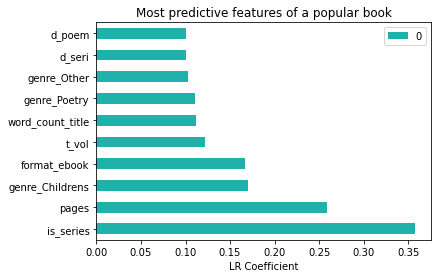

In [49]:
#Plotting the 10 most predicitive coefficients
coef_df.sort_values(by=[0],ascending=False).head(10).plot(kind='barh',color='lightseagreen')
plt.title("Most predictive features of a popular book")
plt.xlabel("LR Coefficient")
plt.show()

We find some of the same features as earlier when we ran the Logistic Regression on non-text features: series, pages, genre_Children. It seems that having 'vol' in the title is also predictive, which makes sense as we assume that vol stands for 'volume' and is in line with the book being part of a series. That is also emphasized by having 'seri' in the bok description as well. 'Poem' in the description also correlates the 'genre_Poetry' predictive power.

We can also instantiate a LR on description only to get the most predictive words:

In [60]:
#Instantiate the final LR model on the full train set
lr=LogisticRegression(C=0.001, max_iter=1000, n_jobs=-1,random_state=1)

#Fit the model on train data
desc_logreg=lr.fit(desc_train_df, y_train)

#Score the model
print("Remainder score: ",desc_logreg.score(desc_train_df,y_train)),
print("Test score: ",desc_logreg.score(desc_test_df,y_test))

Remainder score:  0.6600813294483046
Test score:  0.6310194672131147


In [61]:
#putting the coef in a dataframe
desc_coef_df=pd.DataFrame(desc_logreg.coef_[0],desc_train_df.columns)
desc_coef_df.sort_values(by=[0],ascending=False).head(10)

,0
d_volum,0.144745
d_seri,0.134140
d_collect,0.103216
d_battl,0.102415
d_god,0.100341
d_book,0.094828
d_fight,0.092775
d_continu,0.092019
d_poem,0.091948
d_final,0.083316


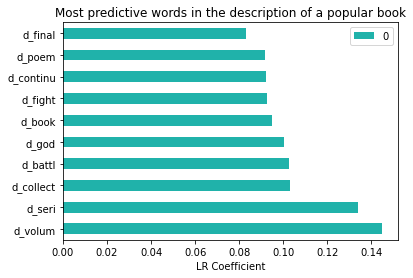

In [66]:
#Plotting the 10 most predicitive coefficients
desc_coef_df.sort_values(by=[0],ascending=False).head(10).plot(kind='barh',color='lightseagreen')
plt.title("Most predictive words in the description of a popular book")
plt.xlabel("LR Coefficient")
plt.show()

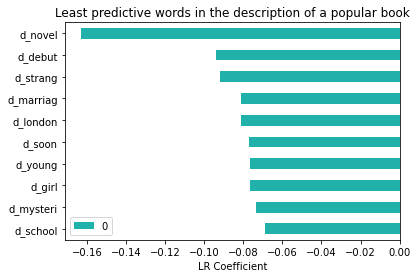

In [69]:
#Plotting the 10 least predicitive coefficients
desc_coef_df.sort_values(by=[0],ascending=False).tail(10).plot(kind='barh',color='lightseagreen')
plt.title("Least predictive words in the description of a popular book")
plt.xlabel("LR Coefficient")
plt.show()

# 2. TF-IDF

As explained in the introduction, TF-IDF is another way of vectorizing the words, but instead of giving the same weight to all the words, words that are very common will have a lower weight while words than are less common willhave a higher weight. This model assumes that words that are infrequent could be just as if not more important than frequent words.

## 2.1 Quick LR with TFIDF

Instead of running all of the steps above, we can fit a pipeline with TF-IDF vectorizer to see if it improves the accuracy and if it is worth exploring further.

In [50]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [51]:
#Instantiate the pipeline

logreg = Pipeline(
    [
        ("vectorizer", TfidfVectorizer(lowercase=True, stop_words='english', min_df=15)),
        ("classifier", LogisticRegression(max_iter=1000,C=0.001)),
    ]
)

#Fit the pipeline
logreg.fit(X_train['description'],y_train);

In [52]:
# accuracy scores
print(f"train accuracy: {logreg.score(X_train['description'], y_train)}")
print(f"test accuracy: {logreg.score(X_test['description'], y_test)}")

train accuracy: 0.5156735295059396
test accuracy: 0.515625


In [53]:
#Instantiate the pipeline on TITLE

logreg = Pipeline(
    [
        ("vectorizer", TfidfVectorizer(lowercase=True, stop_words='english', min_df=15)),
        ("classifier", LogisticRegression(max_iter=1000,C=0.1)),
    ]
)

#Fit the pipeline
logreg.fit(X_train['title'],y_train);

In [54]:
# accuracy scores
print(f"train accuracy: {logreg.score(X_train['title'], y_train)}")
print(f"test accuracy: {logreg.score(X_test['title'], y_test)}")

train accuracy: 0.6053920783836573
test accuracy: 0.5603227459016393


The description scored 64.1% on the test score, and the title scored 56%. That is not much better than before, so we will stop there for TF-IDF. 

# Conclusion

Word representation with Bag-of-Words and TF-IDF are very big, we saw that our matrices reached almost 100,000 dimensions. Even after dimension reduction, they still had alsmot 1000 columns. This makes models really expensive to run, and the reason why we choose to not run KNN or Decision Trees on those datasets.

In Part 4, we will look at word embedding techniques, Word2Vec and GloVe, which are produced by neural networks and low dimensional.